In [43]:
# Import
import numpy as np
import matplotlib.pyplot as plt
import scipy.io.wavfile as wav
import IPython
import warnings

import librosa as lb

In [59]:
# Costanti
FS = 48000 # frequenza di campionamento dei file del dataSet
track="dataSet/temp.wav"
noise_wav="dataSet/noise.wav"

Progetto: Tentativo di rimuovere eventuali rumori da tracce registrate mediante un giradischi

In [60]:
# Riproduciamo il brano di partenza contenente il rumore
IPython.display.Audio(track)

In [15]:
# Rumore isolato
IPython.display.Audio(noise_wav)

In [49]:
# Analizziamo il rumore
nfs, noise = wav.read(noise_wav) # Questo comando carica il segnale e restituisce : frequenza_campionamento, segnale (array interi)

N = len(noise) # Lunghezza dell'array noise (dei campioni)

# Proviamo a calcolare la trasformata di Fourier con la funzione np.fft.fft di numpy
nf = nfs/N * np.arange(N) # asse delle frequenze
FFT_noise = np.fft.fft(noise)/N # DFT dell'intero array
noise_freq = np.fft.fftfreq(N, 1/nfs) 

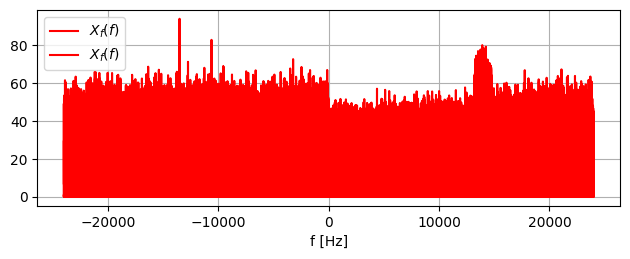

In [51]:
plt.subplot(2,1,2)
plt.plot(noise_freq,np.abs(FFT_noise),'-r',label="$X_f(f)$")
plt.xlabel('f [Hz]')
plt.legend()
plt.tight_layout()
plt.grid()

L'approccio con una singola Trasformata di Fourier (FFT) sull'intero brano è inadatto, perché tratta il segnale come statico. Così facendo, si ottiene uno spettro che ha un'altissima risoluzione in frequenza, ma perdiamo completamente i riferimenti temporali. Si perde tutta l'informazione su quando una frequenza appare.

Dato che la musica è un segnale non-stazionario (che evolve continuamente), dobbiamo passare a una Short-Time Fourier Transform (STFT). Analizzando il segnale a fette cosi' mantenendo il legame frequenza-tempo

In [ ]:
N_FFT = 2048 # Dimensione della finestra della STFT
HL = 512 # Overlap-Add, dopo aver analizzato i primi 2048 campioni non passo ai 2048 successivi ma ai 2048/4 successivi (512), necessario per non creare artefatti (sovrapposizione)

In [40]:
noise, sr = lb.load(noise_wav, sr=FS) # come per wav.read, ma crea un array di Float piuttosto che di Interi con Frequenza di Campionamento pari a FS = 48000Hz
STFT_noise = lb.stft(noise, n_fft = N_FFT, hop_length=HL) # eseguo la trasformata di Fourier (STFT) con le finestre prescelte

noise_mod = np.abs(STFT_noise) # considero il modulo della trasformata (freq, time)
noise_profile = np.mean(noise_mod, axis=1) # esegue la media di tutti i moduli delle stft generate, con axis=1 specifico che considero le frequenze

f = lb.fft_frequencies(sr=sr, n_fft=N_FFT) # asse delle frequenze
noise_profile_db = lb.amplitude_to_db(noise_profile, ref=np.max) # converte i float delle frequenze dell'array noise in decibel

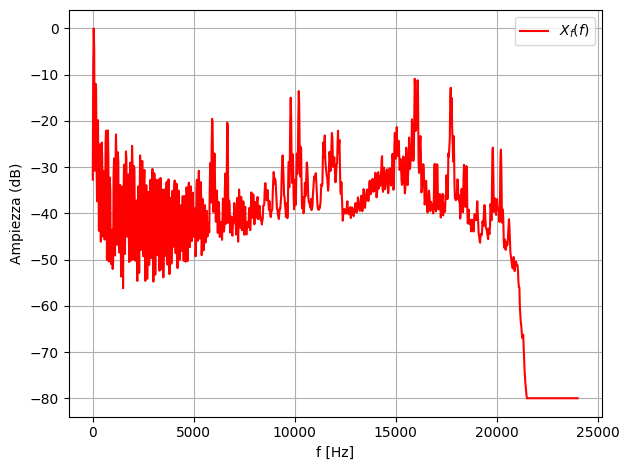

In [42]:
plt.plot(f, noise_profile_db,'-r',label="$X_f(f)$")
plt.xlabel('f [Hz]')
plt.ylabel('Ampiezza (dB)')
plt.legend()
plt.tight_layout()
plt.grid()

Otteniamo cosi' un profilo nel dominio delle frequenze del rumore

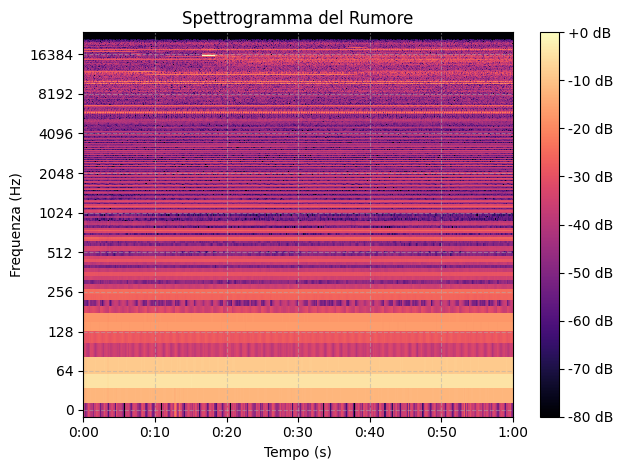

In [58]:
# Spettrogramma:
noise_mod_db = lb.amplitude_to_db(noise_mod, ref=np.max)
lb.display.specshow(noise_mod_db, sr=sr, hop_length=HL, x_axis='time', y_axis='log')

plt.colorbar(format='%+2.0f dB') 
plt.title('Spettrogramma del Rumore')
plt.xlabel('Tempo (s)')
plt.ylabel('Frequenza (Hz)')
plt.tight_layout()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

Notiamo come il rumore e' pressocche' costante (continuita' delle bande)